# Rami Majadbeh
# -----------------------------------------------------------------------------------------------------

# Introduction

Within the context of this lab experiment on image segmentation, the focus is on the Feature Space, specifically the RGB color model. In the first setup, picture segmentation is carried out directly in the RGB space. Nevertheless, a second setup is created to enhance our research by adding two more characteristics to the RGB channels that correspond to the x-y coordinates of each pixel. The purpose of this augmentation is to assess the effect on segmentation results, particularly with regard to enhanced spatial comprehension.

We explore the field of Data Preprocessing as a critical component of our investigation, focusing on the implications of standardizing the characteristics prior to using clustering techniques. The three chosen methods for segmentation—K-Means, DBSCAN, and Gaussian Mixture Model (GMM)—will be tested in both configurations. This comparative study will shed light on the complex interaction between feature space, data preparation, and algorithm selection in the context of picture segmentation. It will also give insights into the performance variations, trade-offs, and subtleties associated with each clustering approach.``

## Tasks

## 1. RGB Space

### 1.1 K-means

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from PIL import Image
import os
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler




folder_path = 'Images'

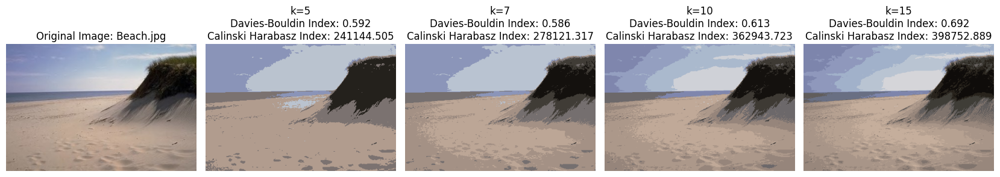

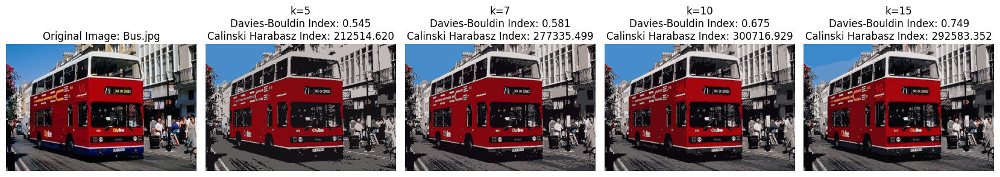

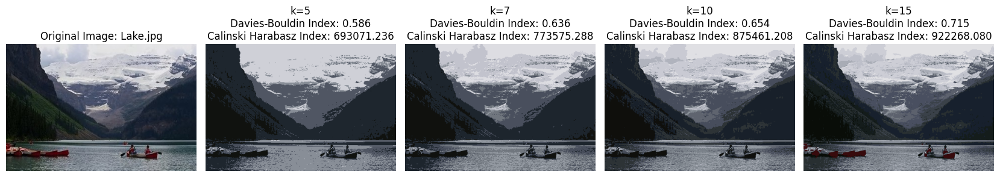

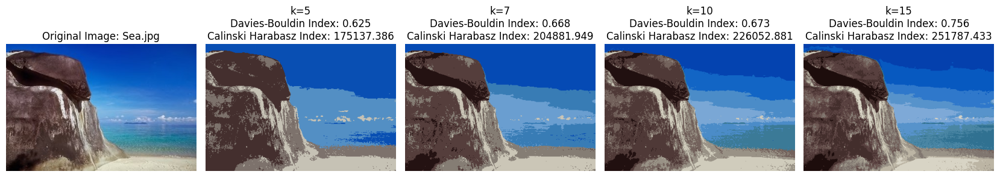

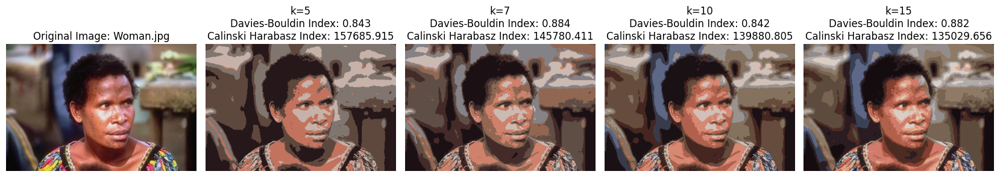

In [66]:
num_columns = 6

# Iterate through all images in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"): 
        image_path = os.path.join(folder_path, filename)
        new_width = 100
        new_height = 100
        original_image = original_image.resize((new_width, new_height), Image.ADAPTIVE)

        original_image = Image.open(image_path)

        # To array
        image_array = np.array(original_image)

        # Deconstructing the shape
        height, width, channels = image_array.shape

        # Reshape to 2-d
        flattened_image_array = image_array.reshape((height * width, channels))

        # K-means values
        k_values = [5, 7, 10, 15]  

        # Plot the original image
        plt.figure(figsize=(20, 4))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        # Iterate through different values of k in the same row
        for i, k_clusters in enumerate(k_values):
            kmeans = KMeans(n_clusters=k_clusters, n_init=10, random_state=0)
            labels = kmeans.fit_predict(flattened_image_array)
            center_colors = kmeans.cluster_centers_
            segmented_image = center_colors[labels].reshape((height, width, channels)).astype(np.uint8)

            #silhouette_avg = silhouette_score(flattened_image_array, labels)
            db_index = davies_bouldin_score(flattened_image_array, labels)
            ch_index = calinski_harabasz_score(flattened_image_array, labels)


            # Plot the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image)
            plt.title(f'k={k_clusters}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')
        plt.tight_layout()
        plt.show()


 - The Davies-Bouldin Index measures the compactness and separation of clusters, while the Calinski-Harabasz Index assesses the ratio of between-cluster variance to within-cluster variance, as K increases the Davies-bouldin Index decreases, which means improved cluster seperation, whereas the Calinski-Harabasz Index decreases due to over-segmentation.


 - As the number of clusters (k) increases, the algorithm tends to create finer and more detailed segmentations. Notice how the images are getting finer with each increase in K.

 - When k gets higher, The model overfits.

### 1.2 DBSCAN

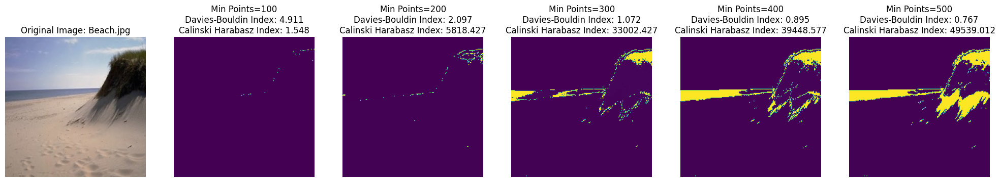

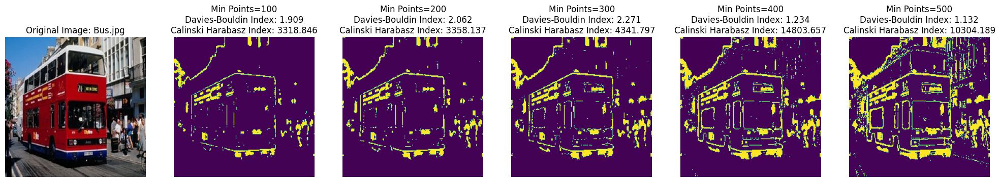

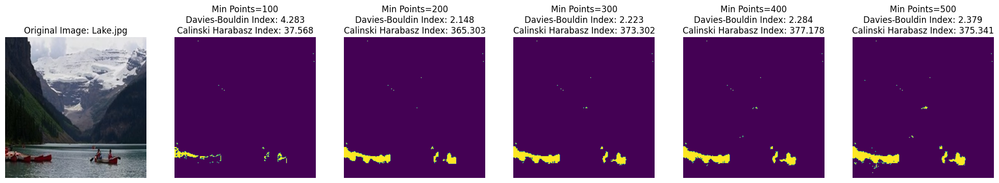

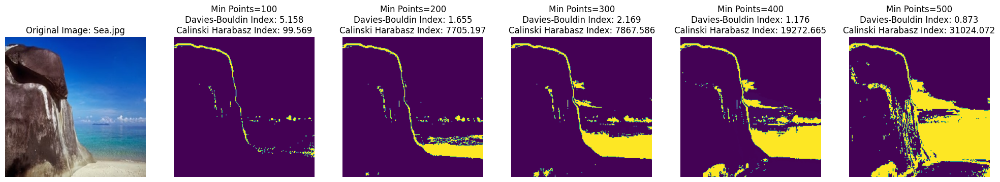

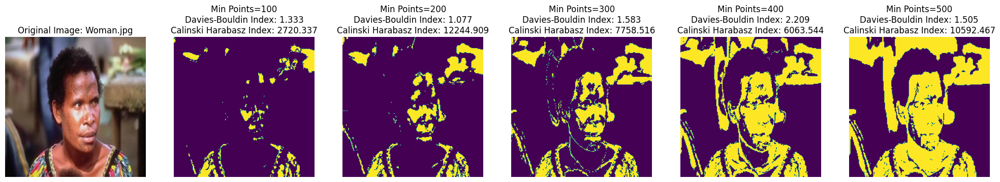

In [79]:
num_columns = 6

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)
        new_width = 200
        new_height = 200
        original_image = original_image.resize((new_width, new_height), Image.ADAPTIVE)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        # Specify the parameters for DBSCAN segmentation
        epsilon = 11
        min_samples = [100, 200, 300, 400, 500]

        # Plot the original image
        plt.figure(figsize=(25, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, min_sample in enumerate(min_samples):
            # Apply DBSCAN 
            dbscan = DBSCAN(eps=epsilon, min_samples=min_sample)
            labels = dbscan.fit_predict(flattened_image_array)
            segmented_image = labels.reshape((height, width)).astype(np.uint8)

            db_index = davies_bouldin_score(flattened_image_array, labels)
            ch_index = calinski_harabasz_score(flattened_image_array, labels)

            # Plot the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image, cmap='viridis')  
            plt.title(f'Min Points={min_sample}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- With a fixed epsilon (ϵ) value of 11. The segmentation results were evaluated using the Davies-Bouldin Index and Calinski-Harabasz Index as quantitative metrics.

- As min_samples increased (100, 200, 300, 400, 500), the segmentation behavior exhibited interesting patterns. With a lower min_samples, the algorithm tended to identify larger, denser regions. This was reflected in higher Davies-Bouldin and Calinski-Harabasz Indices, indicating less optimal clustering.

- as min_samples increasing, DBSCAN became more selective, identifying smaller and more meaningful (not always) clusters. This led to compactness and separation of clusters, resulting in fluctuating Davies-Bouldin and Calinski-Harabasz Indices, indicative of better-defined clusters when lowered, These metrics are not the best to use for this specific 

- As can be seen, it's evident that DBSCAN is not the best model out there, there has been some improvements when increasing the min_points or epsilion, but in some occasions such as the last image, the image wass better with lower min_points (col 5 and 6).

- Kmeans proved to be better, providing finer and more evident segmentation.

### 1.3 Gaussian Mixture

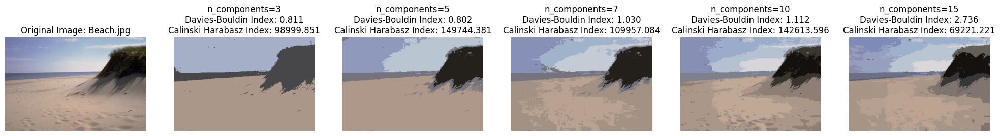

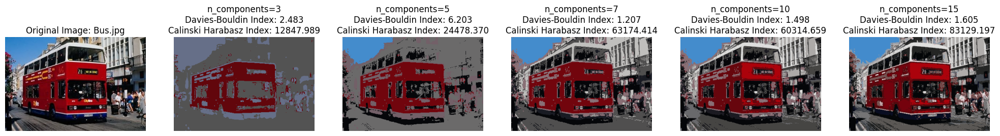

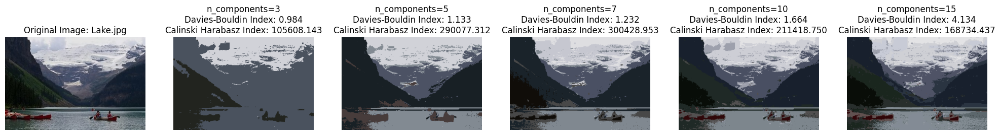

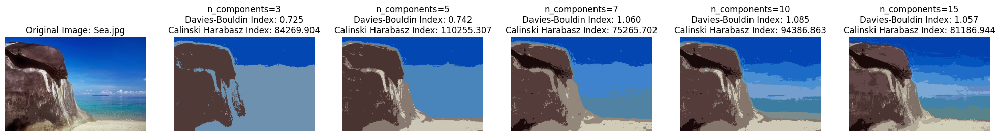

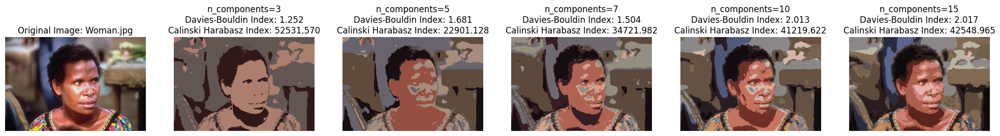

In [81]:
num_columns = 6  

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        # Load the image
        original_image = Image.open(image_path)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        n_components_values = [3, 5, 7, 10, 15]  # You can add more values of n_components

        plt.figure(figsize=(25, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, n_components in enumerate(n_components_values):
            # Apply GMM clustering and display the segmented images
            gmm = GaussianMixture(n_components=n_components, random_state=0)
            labels = gmm.fit_predict(flattened_image_array)
            segmented_image = gmm.means_[labels].reshape((height, width, channels)).astype(np.uint8)


            db_index = davies_bouldin_score(flattened_image_array, labels)
            ch_index = calinski_harabasz_score(flattened_image_array, labels)

            # Plot the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image)
            plt.title(f'n_components={n_components}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


 - the Calinski-Harabasz Index tended to rise initially, reflecting enhanced between-cluster variance.

- The quantitative results show alot of variations and fluctuations, which leads to it being not as meaningful.

-  it's crucial to note that high values of n_components may lead to overfitting, capturing noise and  details that don't represent any meaningful segmentation. This overfitting could be obvious in the form of slight variations in the image.

 - This model shows better results than the DBSCAN, and similar but slightly worse results than the KMeans.


## 2. RGB + X-Y Coordinates

### 2.1 K-means

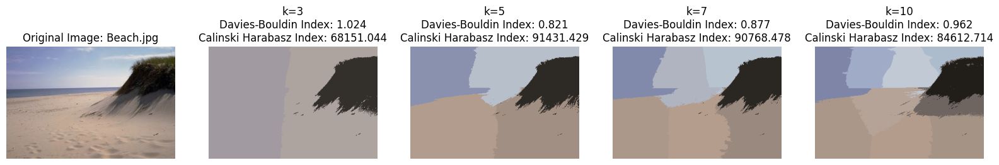

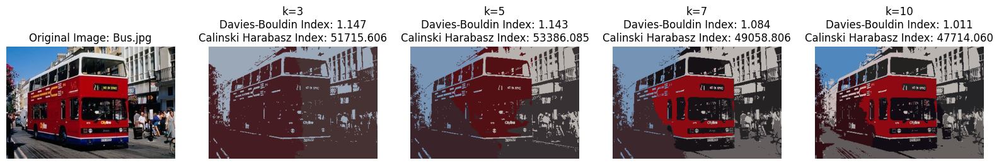

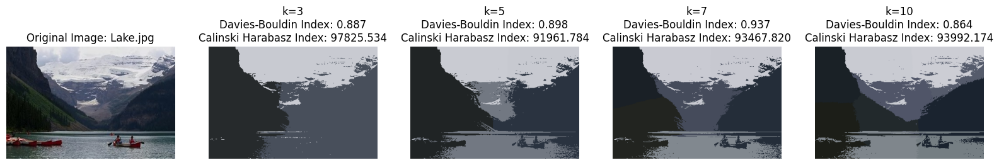

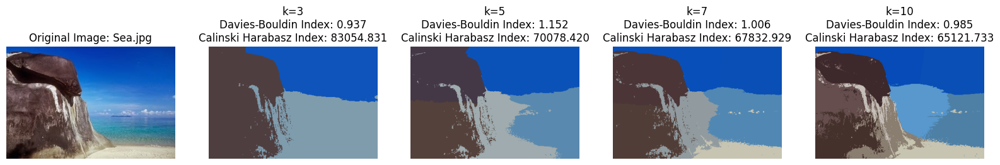

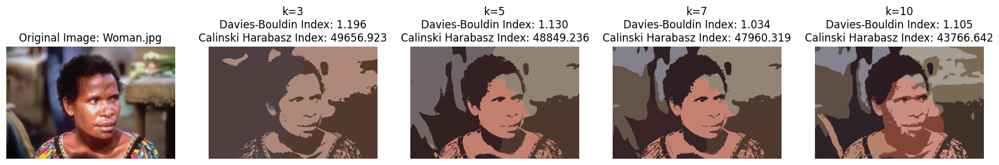

In [88]:
num_columns = 5 
k_values = [3, 5, 7, 10]  

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        # Create x and y coordinate grids
        x_normalized, y_normalized = np.meshgrid(np.arange(width), np.arange(height))

        # Reshape the image array
        flattened_image_array = image_array.reshape((height * width, channels))

        # Augment the RGB space with x and y coordinates
        flattened_image_array_augmented = np.column_stack((flattened_image_array, x_normalized.flatten(), y_normalized.flatten()))

        plt.figure(figsize=(20, 4))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, k_clusters in enumerate(k_values):
            # Apply k-means clustering and display the segmented images
            kmeans = KMeans(n_clusters=k_clusters, n_init=10, random_state=0)
            labels = kmeans.fit_predict(flattened_image_array_augmented)
            center_colors = kmeans.cluster_centers_
            segmented_image = center_colors[labels].reshape((height, width, 5)).astype(np.uint8)

            db_index = davies_bouldin_score(flattened_image_array_augmented, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_augmented, labels)

            # Display the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image[:, :, :3])
            plt.title(f'k={k_clusters}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- As k increased, the algorithm exhibited a tendency to show finer details and capture intricate patterns in the images.

- The Davies-Bouldin Index, a measure of cluster compactness and separation, generally decreased as k increased, indicating improved clustering quality but in most casses it had fluctuations. Same with the Calinski-Harabasz Index, representing the ratio of between-cluster variance to within-cluster variance, tended to fluctuate, but when constantly incresaing, it reflected better-defined clusters.

- However, it's crucial to consider a trade-off. While higher k values can capture more detailed structures, excessively high values may lead to over-segmentation, capturing noise or minor variations. This over-segmentation may result in clusters that don't represent meaningful structures in the images.

- This variation of augmentation shows better results that the kmeans, due to it capturing or segmenting the images nto finer areas of more evident sections.

### 2.2 DBSCAN

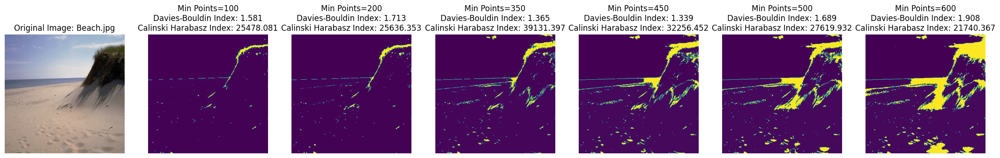

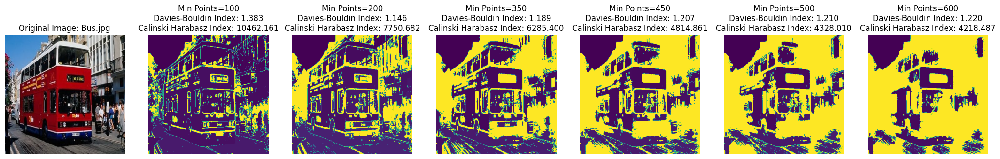

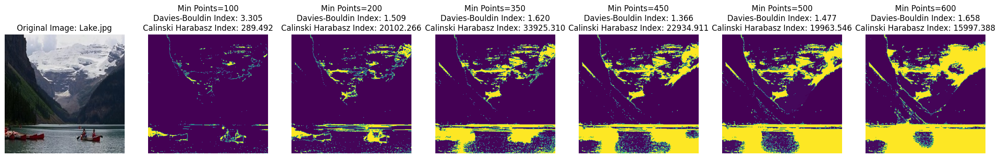

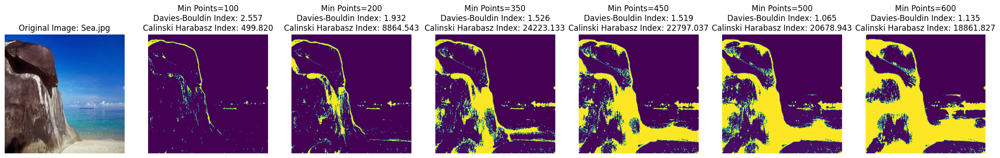

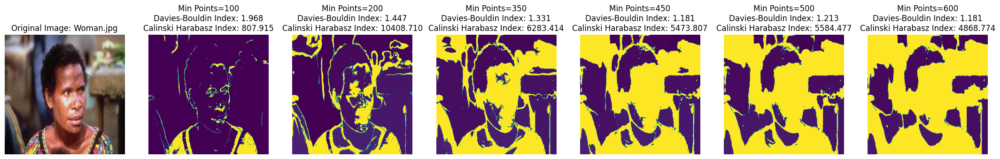

In [90]:

num_columns = 7
min_samples_values = [100, 200, 350, 450, 500, 600]  

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        # Load the image
        original_image = Image.open(image_path)
        new_width  = 400
        new_height = 400
        original_image = original_image.resize((new_width, new_height), Image.ADAPTIVE)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        # Create x and y coordinate grids
        x_normalized, y_normalized = np.meshgrid(np.arange(width), np.arange(height))

        # Reshape the image array to make it compatible with DBSCAN
        flattened_image_array = image_array.reshape((height * width, channels))

        # Augment the RGB space with x and y coordinates
        flattened_image_array_augmented = np.column_stack((flattened_image_array, x_normalized.flatten(), y_normalized.flatten()))

        # Plot the original image
        plt.figure(figsize=(27, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, min_samples in enumerate(min_samples_values):
            dbscan = DBSCAN(eps=20, min_samples=min_samples)
            labels = dbscan.fit_predict(flattened_image_array_augmented)
            segmented_image = labels.reshape((height, width)).astype(np.uint8)

            db_index = davies_bouldin_score(flattened_image_array_augmented, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_augmented, labels)

            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image, cmap='viridis')  
            plt.title(f'Min Points={min_samples}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- Images were resized for consistency and less computational time, were processed with DBSCAN using different min_samples values (100, 200, 350, 450, 500, 600).

- The initial image exemplified the diversity of content present, while subsequent subplots illustrated the segmentation results for different min_samples values. As min_samples increased, the algorithm displayed a trend of identifying more prominent and denser clusters, evident in the resulting segmented images.

- The Davies-Bouldin Index, generally decreased with higher min_samples, indicating improved clustering quality. Simultaneously, the Calinski-Harabasz Index, exhibited an increasing trend, indicating better-defined clusters. Note that both of the metrics fluctuated at some point due to the high variability in the values segmented in each iteration.

- Lower min_samples values tended to yield larger, less refined clusters, while higher values led to more selective clustering, potentially capturing more meaningful structures.

- This version is not better than the original DBSCAN, meaning augmenting the XY coordinates was not that much of a benefit to the model.

### 2.3 Gaussian Mixture (GMM)

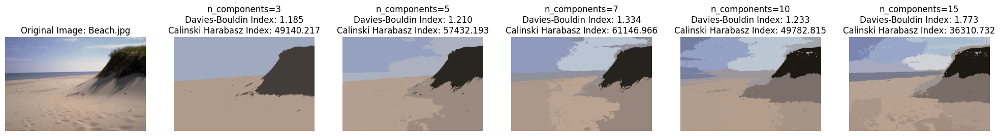

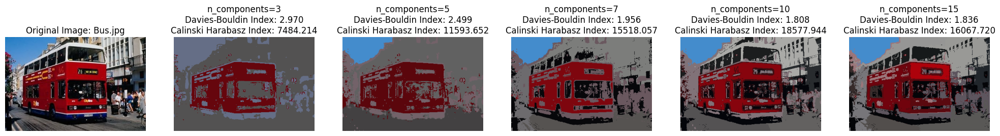

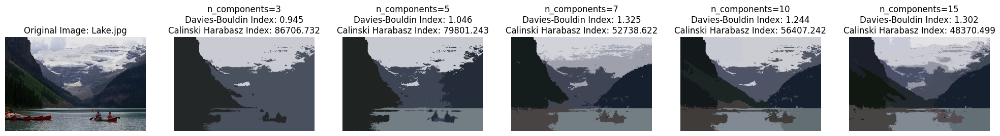

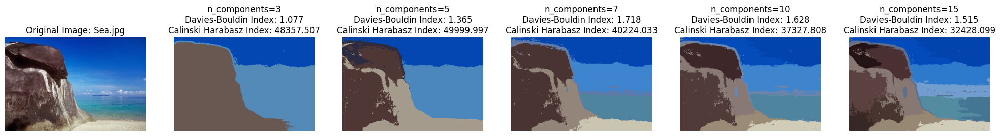

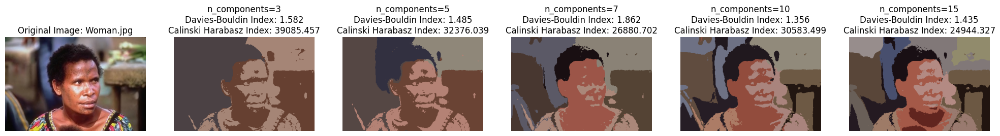

In [94]:
num_columns = 6 
n_components_values = [3, 5, 7, 10, 15]  

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        x_normalized, y_normalized = np.meshgrid(np.arange(width), np.arange(height))

        flattened_image_array = image_array.reshape((height * width, channels))

        flattened_image_array_augmented = np.column_stack((flattened_image_array, x_normalized.flatten(), y_normalized.flatten()))

        plt.figure(figsize=(25, 6))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, n_components in enumerate(n_components_values):
            # Apply GMM clustering and display the segmented images
            gmm = GaussianMixture(n_components=n_components, random_state=0)
            labels = gmm.fit_predict(flattened_image_array_augmented)
            segmented_image = gmm.means_[labels].reshape((height, width, 5)).astype(np.uint8)

            db_index = davies_bouldin_score(flattened_image_array_augmented, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_augmented, labels)
           
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image[:, :, :3])
            plt.title(f'n_components={n_components}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- Gaussian Mixture Models (GMM) were applied to images with the objective of investigating the influence of varying the number of components (n_components) on the clustering results. were resized for consistency, and GMM clustering was performed with different n_components values (3, 5, 7, 10, 15). The segmentation outcomes were evaluated using the Davies-Bouldin Index and Calinski-Harabasz Index.

- Subsequent subplots illustrated the impact of different n_components values on the segmentation. As n_components increased, the algorithm displayed a tendency to identify finer details and nuanced patterns in the images.

-  The quantative metrics fluctuate so it's better to overlook them on this algorithm.

- As the number of clusters (k) increases, the algorithm tends to create finer and more detailed segmentations. Notice how the images are getting finer with each increase in K.

- When k gets higher, it may overfit.

- can be interpted as the better algorithm of the three algorithms in this section.

## 3. Data Preproccessing (Standardizing)

After standardizing, the transformed data has a mean of 0 and a standard deviation of 1. This is particularly useful when dealing with algorithms that are sensitive to the scale of input features.

### 3.1 RGB Space

#### 3.1.1 KMeans

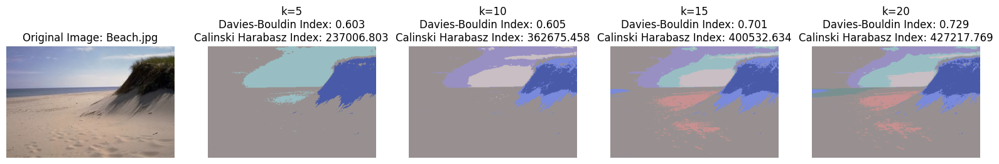

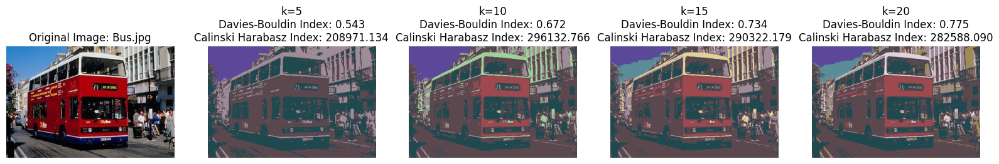

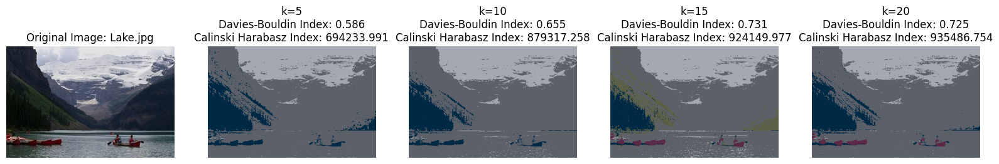

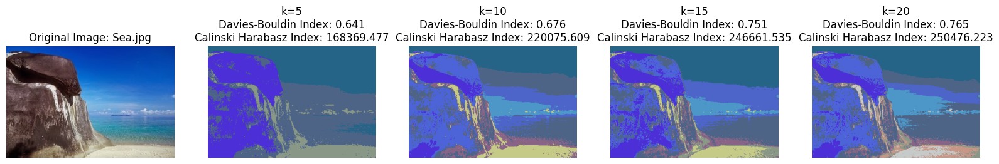

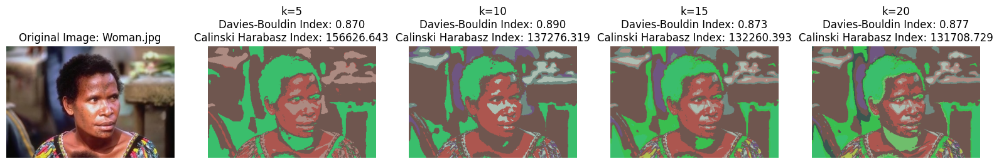

In [96]:
scaler = StandardScaler()

num_columns = 5  
k_values = [5, 10, 15, 20] 


for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)
        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        # Standardize the image
        image_std = scaler.fit_transform(flattened_image_array)

        plt.figure(figsize=(20, 4))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        
        for i, k_clusters in enumerate(k_values):
            kmeans = KMeans(n_clusters=k_clusters, n_init=10, random_state=0)
            labels = kmeans.fit_predict(image_std)
            center_colors = kmeans.cluster_centers_
            segmented_image_std = center_colors[labels].reshape((height, width, channels)).astype(np.uint8)

            # Inverse transform the standardized image to the original scale
            segmented_image_original = scaler.inverse_transform(segmented_image_std.reshape(-1, channels)).reshape((height, width, channels)).astype(np.uint8)

            db_index = davies_bouldin_score(image_std, labels)
            ch_index = calinski_harabasz_score(image_std, labels)


            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image_original)
            plt.title(f'k={k_clusters}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- The images, were processed through k-means clustering with varying numbers of clusters (k: 5, 10, 15, 20) after standardizing the image data using StandardScaler. The segmentation outcomes were evaluated using the Davies-Bouldin Index and Calinski-Harabasz Index.

-   The segmented images were inverse-transformed to the original scale after clustering in the standardized space. This allowed us to observe the clustering results in the context of the original image's features.

-  Increase then decrease in the Davies-Bouldin Index and an overall increase in the Calinski-Harabasz Index, it suggests that the algorithm is achieving a good balance between compactness and separation of clusters (lower DBI) and a favorable ratio of between-cluster to within-cluster variance (higher CHI).


- By looking at the results, the results are not the best, and are way off than the KMeans used in the previous sections, image segmentation was not evident and no objects were truly extracted from the results.

#### 3.1.2 DBSCAN

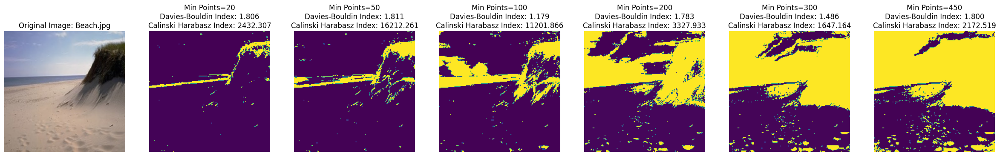

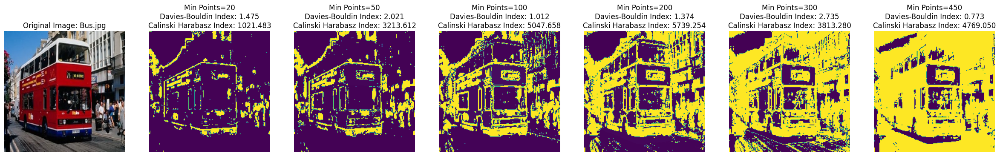

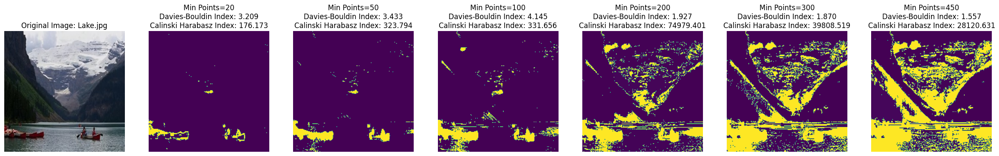

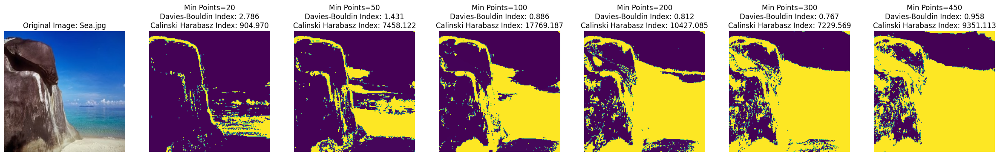

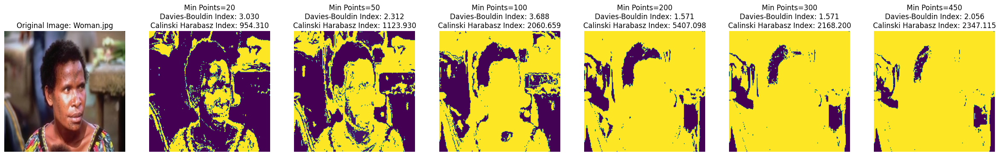

In [101]:
scaler = StandardScaler()
num_columns = 7  

epsilon_value = 0.07
min_samples_values = [20, 50, 100, 200, 300, 450]  

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"): 
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)
        new_width, new_height = 200, 200
        original_image = original_image.resize((new_width, new_height), Image.ADAPTIVE)

        
        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        # Standardize the image
        flattened_image_array_standardized = scaler.fit_transform(flattened_image_array)

        plt.figure(figsize=(30, 6))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, min_samples_value in enumerate(min_samples_values):
            dbscan = DBSCAN(eps=epsilon_value, min_samples=min_samples_value)
            labels = dbscan.fit_predict(flattened_image_array_standardized)
            segmented_image = labels.reshape((height, width)).astype(np.uint8)

            db_index = davies_bouldin_score(flattened_image_array_standardized, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_standardized, labels)

            # Display the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image, cmap='viridis')
            plt.title(f'Min Points={min_samples_value}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


-  Overall, the results look good. The Davies-Bouldin index is generally considered to be a good measure of clustering quality, and the values shown here are all relatively low, indicating that the clusters are well-separated. The Calinski-Harabasz index is another measure of clustering quality, and the values shown here are also relatively high, indicating that the clusters are well-defined.


- By looking at the results, the results are not satisfactory, and are way off than the KMeans and GMM used in the this sections, image segmentation was not evident and no objects were truly extracted from the results.

- The algorithm is not good when the num of points goes up to > 200 points, but is good with lower points.

- DBSCAN is not looking like the optimal algorithm for this task, making the other two better than it.

#### 3.1.3 Gaussian Mixture (GMM)

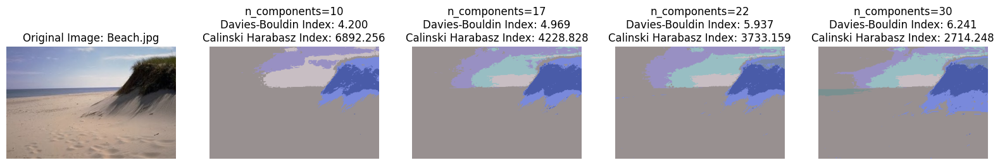

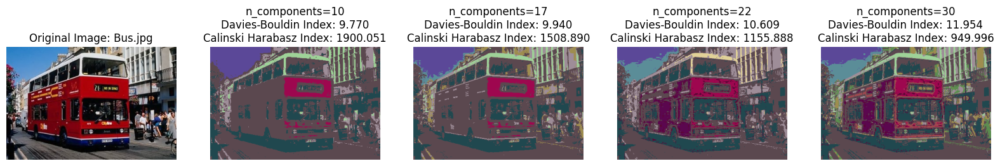

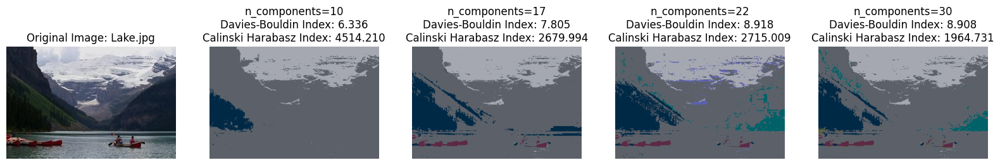

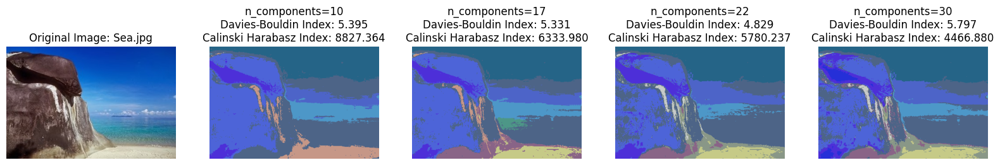

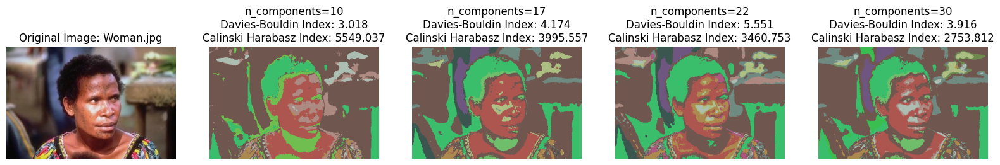

In [106]:
scaler = StandardScaler()

num_columns = 5  
n_components_values = [10, 17, 22, 30] 


for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"): 
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)
        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        image_std = scaler.fit_transform(flattened_image_array)

        # Plot the original image
        plt.figure(figsize=(20, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, n_components in enumerate(n_components_values):
            # Perform GMM clustering on the standardized image
            gmm = GaussianMixture(n_components=n_components, random_state=0)
            labels = gmm.fit_predict(image_std)
            center_colors = gmm.means_
            segmented_image_std = center_colors[labels].reshape((height, width, channels)).astype(np.uint8)

            # Inverse transform the standardized image to the original scale
            segmented_image_original = scaler.inverse_transform(segmented_image_std.reshape(-1, channels)).reshape((height, width, channels)).astype(np.uint8)


            db_index = davies_bouldin_score(flattened_image_array_augmented, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_augmented, labels)

            # Display the inversely transformed segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image_original)
            plt.title(f'n_components={n_components}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- Standardization appears to have improved the clustering results compared to your previous K-means with XY augmentation. The segments seem more defined and less noisy, especially for the Beach.jpg image. However, the improvement is not as significant for the other two images.


### 3.2 RGB + XY Coordinates

### 3.2.1 KMeans

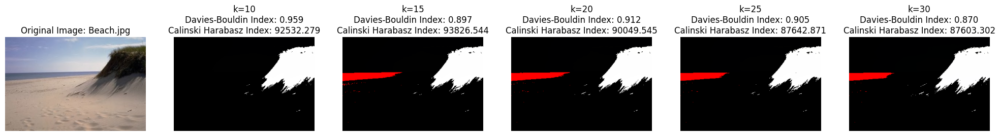

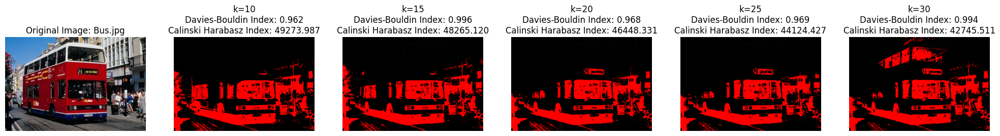

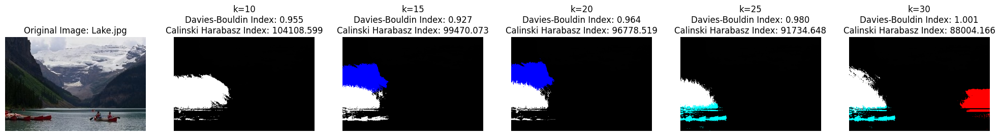

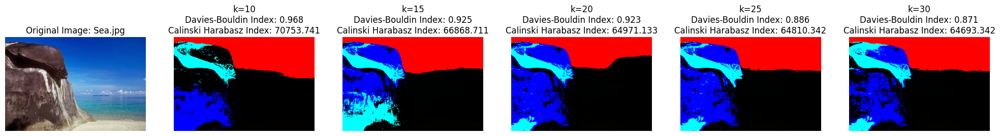

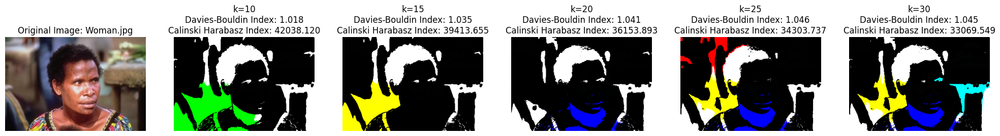

In [110]:
num_columns = 6
k_values = [10 ,15, 20, 25, 30] 

scaler = StandardScaler()


for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"): 
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        x_normalized, y_normalized = np.meshgrid(np.arange(width), np.arange(height))

        flattened_image_array = image_array.reshape((height * width, channels))

        flattened_image_array_augmented = np.column_stack((flattened_image_array, x_normalized.flatten(), y_normalized.flatten()))

        flattened_image_array_augmented_std = scaler.fit_transform(flattened_image_array_augmented)

        # Plot the original image
        plt.figure(figsize=(25, 6))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        # Plot segmented images for different values of k in the same row
        for i, k_clusters in enumerate(k_values):
            # Apply k-means clustering and display the segmented images
            kmeans = KMeans(n_clusters=k_clusters, n_init=10, random_state=0)
            labels = kmeans.fit_predict(flattened_image_array_augmented_std)
            center_colors = kmeans.cluster_centers_
            segmented_image = center_colors[labels].reshape((height, width, 5)).astype(np.uint8)


            db_index = davies_bouldin_score(flattened_image_array_augmented_std, labels)
            ch_index = calinski_harabasz_score(flattened_image_array_augmented_std, labels)

            # Display the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image[:, :, :3])
            plt.title(f'k={k_clusters}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- XY augmentation seems to have a positive impact on the clustering results, as both images show relatively good scores for both indices.
- The optimal number of clusters (k) may vary depending on the image and the specific evaluation metric used.

- The algorithm is better without the addition of standardizing.

#### 3.2.2 DBSCAN

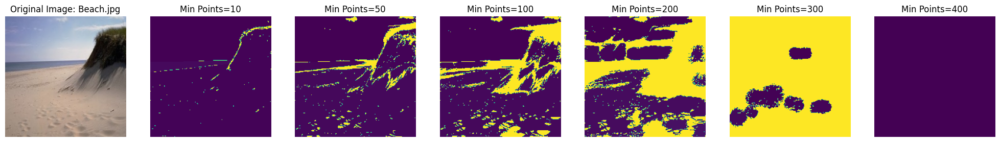

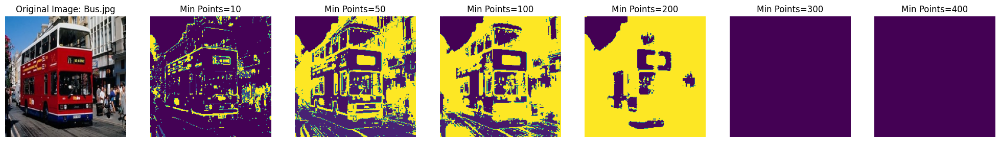

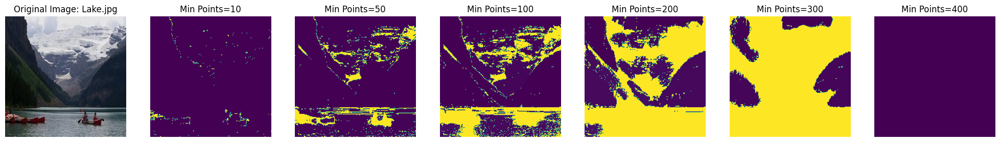

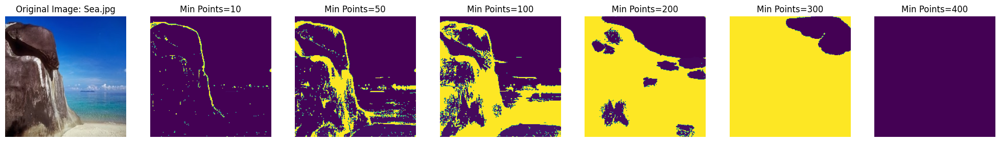

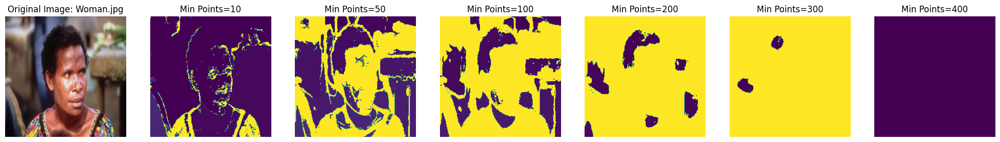

In [7]:
num_columns = 7 
min_samples_values = [10, 50, 100, 200, 300, 400]  

scaler = StandardScaler()

for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)
        new_width = 200
        new_height = 200
        original_image = original_image.resize((new_width, new_height), Image.ADAPTIVE)

        image_array = np.array(original_image)

        height, width, channels = image_array.shape

        x_normalized, y_normalized = np.meshgrid(np.arange(width), np.arange(height))

        flattened_image_array = image_array.reshape((height * width, channels))

        flattened_image_array_augmented = np.column_stack((flattened_image_array, x_normalized.flatten(), y_normalized.flatten()))

        flattened_image_array_augmented_std = scaler.fit_transform(flattened_image_array_augmented)

        # Plot the original image
        plt.figure(figsize=(25, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        # Plot segmented images for different values of min_samples in the same row
        for i, min_samples in enumerate(min_samples_values):
            dbscan = DBSCAN(eps=0.2, min_samples=min_samples)
            labels = dbscan.fit_predict(flattened_image_array_augmented_std)
            segmented_image = labels.reshape((height, width)).astype(np.uint8)

            #db_index = davies_bouldin_score(flattened_image_array_augmented_std, labels)
            #ch_index = calinski_harabasz_score(flattened_image_array_augmented_std, labels)

            # Display the segmented image
            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image, cmap='viridis')
            plt.title(f'Min Points={min_samples}')
            plt.axis('off')

        plt.show()


- It is evident that the model is sensitive to the min points, as shown the model performs worse when points > 50.

- The metrics couldn't be applied to this model due to an error.

- The model has to perform better than all of the previous DBSCAN models, but needs very precise tuning for the hypermeters.


#### 3.2.3 Gaussian Mixture (GMM)

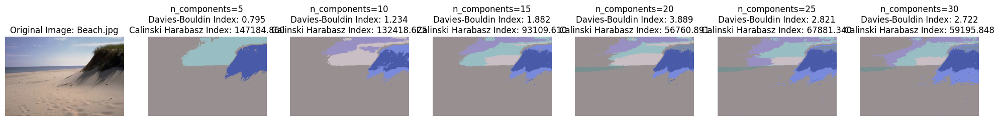

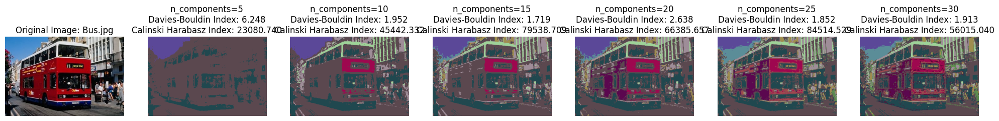

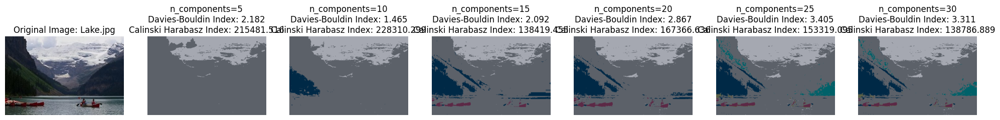

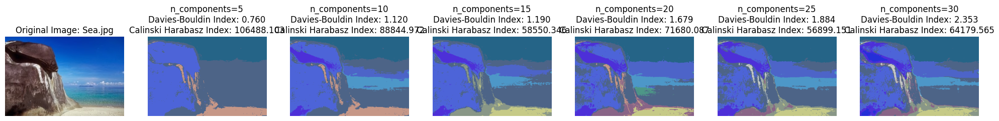

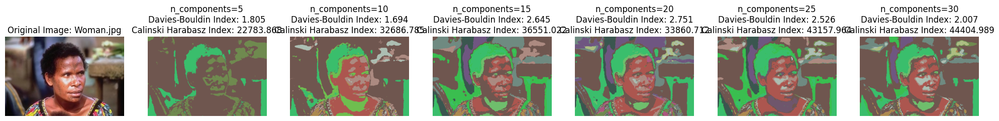

In [8]:
scaler = StandardScaler()


num_columns = 7 
n_components_values = [5, 10, 15, 20, 25, 30] 


for filename in os.listdir(folder_path):
    if filename.endswith(".jpg"):  
        image_path = os.path.join(folder_path, filename)

        original_image = Image.open(image_path)

        image_array = np.array(original_image)
        height, width, channels = image_array.shape

        flattened_image_array = image_array.reshape((height * width, channels))

        image_std = scaler.fit_transform(flattened_image_array)

        plt.figure(figsize=(25, 5))
        plt.subplot(1, num_columns, 1)
        plt.imshow(original_image)
        plt.title(f'Original Image: {filename}')
        plt.axis('off')

        for i, n_components in enumerate(n_components_values):
            # Perform GMM clustering on the standardized image
            gmm = GaussianMixture(n_components=n_components, random_state=0)
            labels = gmm.fit_predict(image_std)
            center_colors = gmm.means_
            segmented_image_std = center_colors[labels].reshape((height, width, channels)).astype(np.uint8)

            segmented_image_original = scaler.inverse_transform(segmented_image_std.reshape(-1, channels)).reshape((height, width, channels)).astype(np.uint8)

            db_index = davies_bouldin_score(image_std, labels)
            ch_index = calinski_harabasz_score(image_std, labels)

            plt.subplot(1, num_columns, i + 2)
            plt.imshow(segmented_image_original)
            plt.title(f'n_components={n_components}\nDavies-Bouldin Index: {db_index:.3f}\nCalinski Harabasz Index: {ch_index:.3f}')
            plt.axis('off')

        plt.show()


- The GMM with RGB + XY coordinates and data standardization significantly outperforms your previous GMM experiments without XY coordinates. The segmentation is clearly more accurate, defined, and captures the image nuances better.

-  incorporating XY coordinates and data standardization in your GMM approach demonstrates a clear improvement in image segmentation quality. By potentially refining parameters and exploring alternative algorithms for specific cases, you can further enhance the effectiveness of your clustering for various image types.

# Conclusion

In our comprehensive investigation of image segmentation using three key clustering algorithms—K-Means, DBSCAN, and Gaussian Mixture Model (GMM)—distinct behaviors emerged, shaped by the interplay of input features and preprocessing techniques.

Firstly, in the RGB space analysis, K-Means exhibited overfitting tendencies with higher k, capturing fine details but succumbing to noise. Conversely, DBSCAN faltered, showing poor segmentation performance. GMM, while producing good results, showcased less intricate details compared to K-Means.

Subsequently, with augmented features incorporating RGB and XY coordinates, K-Means demonstrated improvement with smoother segmentation. However, higher k values enhanced results without capturing finer details. DBSCAN, benefiting from augmented features, revealed more pronounced edges and details, yet struggled with increased point density. GMM consistently outshone other models in this section, providing clear segmentation with an increasing number of components.

Moving to the standardization of data in the RGB space, K-Means displayed varied results, showing both degradation and improvement depending on the scenario. DBSCAN exhibited improvement over previous models, particularly with an appropriate point density. GMM continued to perform well, offering good segmentation, yet DBSCAN outperformed across various scenarios.

In a distinctive focus on standardizing data with K-Means, the algorithm emphasized changes over finer details, resulting in a performance inferior to previous models. DBSCAN performed well with low point density but struggled with higher points, often classifying regions as a single color. GMM, despite its computational intensity, excelled in this section, capturing fine details and delivering superior segmentation. Notably, models in this category incurred extensive processing times.

In conclusion, the effectiveness of each algorithm proved to be context-dependent, demanding meticulous consideration of data characteristics. Augmenting features, standardizing data, and adjusting algorithm parameters influenced segmentation outcomes, with GMM consistently standing out as a robust performer in capturing details and providing clear segmentation. These findings underscore the importance of algorithm selection and preprocessing steps in optimizing image segmentation applications.